# Convolutional Neural Networks

## Project: Write an Algorithm for a Dog Identification App 

---

In this notebook, some template code has already been provided for you, and you will need to implement additional functionality to successfully complete this project. You will not need to modify the included code beyond what is requested. Sections that begin with **'(IMPLEMENTATION)'** in the header indicate that the following block of code will require additional functionality which you must provide. Instructions will be provided for each section, and the specifics of the implementation are marked in the code block with a 'TODO' statement. Please be sure to read the instructions carefully! 

> **Note**: Once you have completed all of the code implementations, you need to finalize your work by exporting the Jupyter Notebook as an HTML document. Before exporting the notebook to html, all of the code cells need to have been run so that reviewers can see the final implementation and output. You can then export the notebook by using the menu above and navigating to **File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission.

In addition to implementing code, there will be questions that you must answer which relate to the project and your implementation. Each section where you will answer a question is preceded by a **'Question X'** header. Carefully read each question and provide thorough answers in the following text boxes that begin with **'Answer:'**. Your project submission will be evaluated based on your answers to each of the questions and the implementation you provide.

>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut.  Markdown cells can be edited by double-clicking the cell to enter edit mode.

The rubric contains _optional_ "Stand Out Suggestions" for enhancing the project beyond the minimum requirements. If you decide to pursue the "Stand Out Suggestions", you should include the code in this Jupyter notebook.



---
### Why We're Here 

In this notebook, you will make the first steps towards developing an algorithm that could be used as part of a mobile or web app.  At the end of this project, your code will accept any user-supplied image as input.  If a dog is detected in the image, it will provide an estimate of the dog's breed.  If a human is detected, it will provide an estimate of the dog breed that is most resembling.  The image below displays potential sample output of your finished project (... but we expect that each student's algorithm will behave differently!). 

![Sample Dog Output](images/sample_dog_output.png)

In this real-world setting, you will need to piece together a series of models to perform different tasks; for instance, the algorithm that detects humans in an image will be different from the CNN that infers dog breed.  There are many points of possible failure, and no perfect algorithm exists.  Your imperfect solution will nonetheless create a fun user experience!

### The Road Ahead

We break the notebook into separate steps.  Feel free to use the links below to navigate the notebook.

* [Step 0](#step0): Import Datasets
* [Step 1](#step1): Detect Humans
* [Step 2](#step2): Detect Dogs
* [Step 3](#step3): Create a CNN to Classify Dog Breeds (from Scratch)
* [Step 4](#step4): Create a CNN to Classify Dog Breeds (using Transfer Learning)
* [Step 5](#step5): Write your Algorithm
* [Step 6](#step6): Test Your Algorithm

---
<a id='step0'></a>
## Step 0: Import Datasets

Make sure that you've downloaded the required human and dog datasets:

**Note: if you are using the Udacity workspace, you *DO NOT* need to re-download these - they can be found in the `/data` folder as noted in the cell below.**

* Download the [dog dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/dogImages.zip).  Unzip the folder and place it in this project's home directory, at the location `/dog_images`. 

* Download the [human dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/lfw.zip).  Unzip the folder and place it in the home directory, at location `/lfw`.  

*Note: If you are using a Windows machine, you are encouraged to use [7zip](http://www.7-zip.org/) to extract the folder.*

In the code cell below, we save the file paths for both the human (LFW) dataset and dog dataset in the numpy arrays `human_files` and `dog_files`.

In [1]:
import numpy as np

from glob import glob
import cv2
import matplotlib.pyplot as plt
from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import torchvision.transforms as transforms

import os
from torchvision import datasets, transforms

use_cuda = torch.cuda.is_available()

In [40]:
import numpy as np
from glob import glob

# load filenames for human and dog images
human_files = np.array(glob("/data/lfw/*/*"))
dog_files = np.array(glob("/data/dog_images/*/*/*"))


# print number of images in each dataset
print('There are %d total human images.' % len(human_files))
print('There are %d total dog images.' % len(dog_files))

There are 13233 total human images.
There are 8351 total dog images.


<a id='step1'></a>
## Step 1: Detect Humans

In this section, we use OpenCV's implementation of [Haar feature-based cascade classifiers](http://docs.opencv.org/trunk/d7/d8b/tutorial_py_face_detection.html) to detect human faces in images.  

OpenCV provides many pre-trained face detectors, stored as XML files on [github](https://github.com/opencv/opencv/tree/master/data/haarcascades).  We have downloaded one of these detectors and stored it in the `haarcascades` directory.  In the next code cell, we demonstrate how to use this detector to find human faces in a sample image.

Number of faces detected: 1


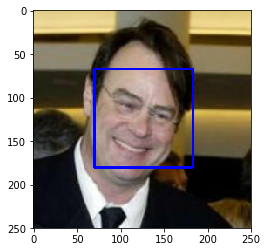

In [3]:
import cv2                
import matplotlib.pyplot as plt                        
%matplotlib inline                               

# extract pre-trained face detector
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')

# load color (BGR) image
img = cv2.imread(human_files[0])
# convert BGR image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# find faces in image
faces = face_cascade.detectMultiScale(gray)

# print number of faces detected in the image
print('Number of faces detected:', len(faces))

# get bounding box for each detected face
for (x,y,w,h) in faces:
    # add bounding box to color image
    cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    
# convert BGR image to RGB for plotting
cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# display the image, along with bounding box
plt.imshow(cv_rgb)
plt.show()

Before using any of the face detectors, it is standard procedure to convert the images to grayscale.  The `detectMultiScale` function executes the classifier stored in `face_cascade` and takes the grayscale image as a parameter.  

In the above code, `faces` is a numpy array of detected faces, where each row corresponds to a detected face.  Each detected face is a 1D array with four entries that specifies the bounding box of the detected face.  The first two entries in the array (extracted in the above code as `x` and `y`) specify the horizontal and vertical positions of the top left corner of the bounding box.  The last two entries in the array (extracted here as `w` and `h`) specify the width and height of the box.

### Write a Human Face Detector

We can use this procedure to write a function that returns `True` if a human face is detected in an image and `False` otherwise.  This function, aptly named `face_detector`, takes a string-valued file path to an image as input and appears in the code block below.

In [4]:
# returns "True" if face is detected in image stored at img_path
def face_detector(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    return len(faces) > 0

### (IMPLEMENTATION) Assess the Human Face Detector

__Question 1:__ Use the code cell below to test the performance of the `face_detector` function.  
- What percentage of the first 100 images in `human_files` have a detected human face?  
- What percentage of the first 100 images in `dog_files` have a detected human face? 

Ideally, we would like 100% of human images with a detected face and 0% of dog images with a detected face.  You will see that our algorithm falls short of this goal, but still gives acceptable performance.  We extract the file paths for the first 100 images from each of the datasets and store them in the numpy arrays `human_files_short` and `dog_files_short`.

__Answer:__ 
(You can print out your results and/or write your percentages in this cell)

In [7]:
from tqdm import tqdm

human_files_short = human_files[:100]
dog_files_short = dog_files[:100]

#-#-# Do NOT modify the code above this line. #-#-#

## TODO: Test the performance of the face_detector algorithm 
## on the images in human_files_short and dog_files_short.
i = 0
for img in human_files_short:
    if face_detector(img):
        i += 1

print(f'Human faces detected in "human files": {i / len(human_files_short) *100}%')        

i = 0        
for img in dog_files_short:
    if face_detector(img):
        i += 1

print(f'Human faces detected in "dog files": {i / len(dog_files_short) *100}%') 



Human faces detected in "human files": 98.0%
Human faces detected in "dog files": 17.0%


We suggest the face detector from OpenCV as a potential way to detect human images in your algorithm, but you are free to explore other approaches, especially approaches that make use of deep learning :).  Please use the code cell below to design and test your own face detection algorithm.  If you decide to pursue this _optional_ task, report performance on `human_files_short` and `dog_files_short`.

In [5]:
### (Optional) 
### TODO: Test performance of anotherface detection algorithm.
### Feel free to use as many code cells as needed.

---
<a id='step2'></a>
## Step 2: Detect Dogs

In this section, we use a [pre-trained model](http://pytorch.org/docs/master/torchvision/models.html) to detect dogs in images.  

### Obtain Pre-trained VGG-16 Model

The code cell below downloads the VGG-16 model, along with weights that have been trained on [ImageNet](http://www.image-net.org/), a very large, very popular dataset used for image classification and other vision tasks.  ImageNet contains over 10 million URLs, each linking to an image containing an object from one of [1000 categories](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a).  

In [5]:
# define VGG16 model
VGG16 = models.vgg16(pretrained=True)

# check if CUDA is available


# move model to GPU if CUDA is available
if use_cuda:
    VGG16 = VGG16.cuda()
    
print(VGG16)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.torch/models/vgg16-397923af.pth
100%|██████████| 553433881/553433881 [00:05<00:00, 101868185.73it/s]


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (17): Conv2d

Given an image, this pre-trained VGG-16 model returns a prediction (derived from the 1000 possible categories in ImageNet) for the object that is contained in the image.

### (IMPLEMENTATION) Making Predictions with a Pre-trained Model

In the next code cell, you will write a function that accepts a path to an image (such as `'dogImages/train/001.Affenpinscher/Affenpinscher_00001.jpg'`) as input and returns the index corresponding to the ImageNet class that is predicted by the pre-trained VGG-16 model.  The output should always be an integer between 0 and 999, inclusive.

Before writing the function, make sure that you take the time to learn  how to appropriately pre-process tensors for pre-trained models in the [PyTorch documentation](http://pytorch.org/docs/stable/torchvision/models.html).

In [6]:
import torch
from PIL import Image
import torchvision.transforms as transforms
import torch.nn.functional as F

def VGG16_predict(img_path):
    '''
    Use pre-trained VGG-16 model to obtain index corresponding to 
    predicted ImageNet class for image at specified path
    
    Args:
        img_path: path to an image
        
    Returns:
        Index corresponding to VGG-16 model's prediction
    '''
    
    ## TODO: Complete the function.
    ## Load and pre-process an image from the given img_path
    image = Image.open(img_path)
    
    transform = transforms.Compose([transforms.RandomResizedCrop(224),
                                    transforms.ToTensor(),
                                    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                                       std=[0.229, 0.224, 0.225])]
                                  )
    
    image = transform(image).unsqueeze(0)
    
    ## Return the *index* of the predicted class for that image
    if use_cuda:
        image = image.cuda()
    output = VGG16(image)
    probs = F.softmax(output, dim=1)
    _, top1 = torch.topk(probs, 1)
    
    return top1.item()

### (IMPLEMENTATION) Write a Dog Detector

While looking at the [dictionary](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a), you will notice that the categories corresponding to dogs appear in an uninterrupted sequence and correspond to dictionary keys 151-268, inclusive, to include all categories from `'Chihuahua'` to `'Mexican hairless'`.  Thus, in order to check to see if an image is predicted to contain a dog by the pre-trained VGG-16 model, we need only check if the pre-trained model predicts an index between 151 and 268 (inclusive).

Use these ideas to complete the `dog_detector` function below, which returns `True` if a dog is detected in an image (and `False` if not).

In [7]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector(img_path):
    ## TODO: Complete the function.
    predicted_class = VGG16_predict(img_path)
    
    return (predicted_class >= 151) and (predicted_class <=268) 

### (IMPLEMENTATION) Assess the Dog Detector

__Question 2:__ Use the code cell below to test the performance of your `dog_detector` function.  
- What percentage of the images in `human_files_short` have a detected dog?  
- What percentage of the images in `dog_files_short` have a detected dog?

__Answer:__ <br>
Detected a dog in human file: 0.0 %
<br>Detected a dog in dogs file: 97.0 %

In [10]:
### TODO: Test the performance of the dog_detector function
### on the images in human_files_short and dog_files_short.
i = 0
for img in human_files_short:
    i += dog_detector(img)
print("Detected a dog in human file:", i/len(human_files_short)*100, '%')
    
i = 0
for img in dog_files_short:
    i += dog_detector(img)
print("Detected a dog in dogs file:", i/len(human_files_short)*100, '%')

Detected a dog in human file: 0.0 %
Detected a dog in dogs file: 97.0 %


We suggest VGG-16 as a potential network to detect dog images in your algorithm, but you are free to explore other pre-trained networks (such as [Inception-v3](http://pytorch.org/docs/master/torchvision/models.html#inception-v3), [ResNet-50](http://pytorch.org/docs/master/torchvision/models.html#id3), etc).  Please use the code cell below to test other pre-trained PyTorch models.  If you decide to pursue this _optional_ task, report performance on `human_files_short` and `dog_files_short`.

In [8]:
### (Optional) 
### TODO: Report the performance of another pre-trained network.
### Feel free to use as many code cells as needed.

---
<a id='step3'></a>
## Step 3: Create a CNN to Classify Dog Breeds (from Scratch)

Now that we have functions for detecting humans and dogs in images, we need a way to predict breed from images.  In this step, you will create a CNN that classifies dog breeds.  You must create your CNN _from scratch_ (so, you can't use transfer learning _yet_!), and you must attain a test accuracy of at least 10%.  In Step 4 of this notebook, you will have the opportunity to use transfer learning to create a CNN that attains greatly improved accuracy.

We mention that the task of assigning breed to dogs from images is considered exceptionally challenging.  To see why, consider that *even a human* would have trouble distinguishing between a Brittany and a Welsh Springer Spaniel.  

Brittany | Welsh Springer Spaniel
- | - 
<img src="images/Brittany_02625.jpg" width="100"> | <img src="images/Welsh_springer_spaniel_08203.jpg" width="200">

It is not difficult to find other dog breed pairs with minimal inter-class variation (for instance, Curly-Coated Retrievers and American Water Spaniels).  

Curly-Coated Retriever | American Water Spaniel
- | -
<img src="images/Curly-coated_retriever_03896.jpg" width="200"> | <img src="images/American_water_spaniel_00648.jpg" width="200">


Likewise, recall that labradors come in yellow, chocolate, and black.  Your vision-based algorithm will have to conquer this high intra-class variation to determine how to classify all of these different shades as the same breed.  

Yellow Labrador | Chocolate Labrador | Black Labrador
- | -
<img src="images/Labrador_retriever_06457.jpg" width="150"> | <img src="images/Labrador_retriever_06455.jpg" width="240"> | <img src="images/Labrador_retriever_06449.jpg" width="220">

We also mention that random chance presents an exceptionally low bar: setting aside the fact that the classes are slightly imabalanced, a random guess will provide a correct answer roughly 1 in 133 times, which corresponds to an accuracy of less than 1%.  

Remember that the practice is far ahead of the theory in deep learning.  Experiment with many different architectures, and trust your intuition.  And, of course, have fun!

### (IMPLEMENTATION) Specify Data Loaders for the Dog Dataset

Use the code cell below to write three separate [data loaders](http://pytorch.org/docs/stable/data.html#torch.utils.data.DataLoader) for the training, validation, and test datasets of dog images (located at `dog_images/train`, `dog_images/valid`, and `dog_images/test`, respectively).  You may find [this documentation on custom datasets](http://pytorch.org/docs/stable/torchvision/datasets.html) to be a useful resource.  If you are interested in augmenting your training and/or validation data, check out the wide variety of [transforms](http://pytorch.org/docs/stable/torchvision/transforms.html?highlight=transform)!

In [1]:
import numpy as np

from glob import glob
import cv2
import matplotlib.pyplot as plt
from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import torchvision.transforms as transforms
import torch.optim as optim

import os
import time
from torchvision import datasets, transforms

from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

use_cuda = torch.cuda.is_available()
print(use_cuda)

True


In [8]:
### TODO: Write data loaders for training, validation, and test sets
## Specify appropriate transforms, and batch_sizes

train_transform = transforms.Compose([transforms.RandomHorizontalFlip(),
                                      transforms.RandomRotation(12),
                                      transforms.Resize((236, 236)),
                                      transforms.CenterCrop(224),
                                      transforms.ToTensor(),
                                      transforms.Normalize(mean=[0.5, 0.5, 0.5],
                                                          std=[0.5, 0.5, 0.5])])

test_transform = transforms.Compose([ transforms.Resize((236, 236)),
                                      transforms.CenterCrop(224),
                                      transforms.ToTensor(),
                                      transforms.Normalize(mean=[0.5, 0.5, 0.5],
                                                          std=[0.5, 0.5, 0.5])])

batch_size = 20

num_workers = 0

#create dataset variables

train_set = datasets.ImageFolder('/data/dog_images/train',
                                   transform = train_transform)

valid_set = datasets.ImageFolder('/data/dog_images/valid',
                                   transform = test_transform)

test_set = datasets.ImageFolder('/data/dog_images/test',
                                  transform = test_transform)

#create DataLoader variables
loaders_scratch = {}
loaders_scratch['train'] = torch.utils.data.DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers = num_workers)
loaders_scratch['valid'] = torch.utils.data.DataLoader(valid_set, batch_size=batch_size, shuffle=False, num_workers = num_workers)
loaders_scratch['test'] = torch.utils.data.DataLoader(test_set, batch_size=batch_size, shuffle=False, num_workers = num_workers)

## Visualize training data

In [3]:
import matplotlib.pyplot as plt
%matplotlib inline

# helper function to un-normalize and display an image
def imshow(img):
    img = img / 2 + 0.5  # unnormalize
    plt.imshow(np.transpose(img, (1, 2, 0)))  # convert from Tensor image

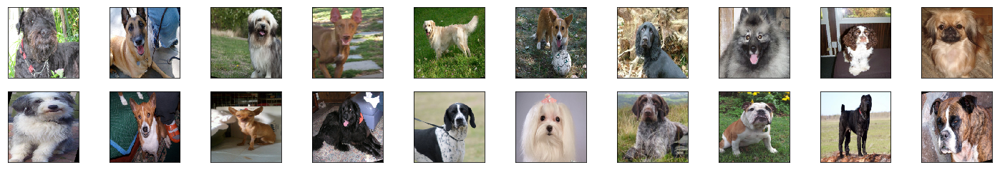

In [62]:
# obtain one batch of training images
dataiter = iter(loaders_scratch['train'])
images, labels = dataiter.next()
images = images.numpy() # convert images to numpy for display

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 4))
# display 20 images
for idx in np.arange(20):
    ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
    imshow(images[idx])


**Question 3:** Describe your chosen procedure for preprocessing the data. 
- How does your code resize the images (by cropping, stretching, etc)?  What size did you pick for the input tensor, and why?
- Did you decide to augment the dataset?  If so, how (through translations, flips, rotations, etc)?  If not, why not?


**Answer**: 
<br> For the training set: 
<br> We augment the dataset with HorizontalFlip and Rotation. 
<br> The augmentation counters the tendency of the network for overfitting. After a rudimentary analysis of the images dataset, we observe that there are many dogs looking to the right or to the left, and many images with tilted heads. 
<br> In specific, with HorizontalFlip(p=0.1), the model start overfitting after epoch 8, while with p=0.5, the validation loss keeps dropping after the 10th epoch.
<br> The accuracy of the model remains fairly good for different Rotation angles in the range 10-15 degrees.

<br> For the input tensor size: The images are first resized to (224, 224) and then center-cropped to 200. These figures are chosen to be multiple times divisible by 2.

<br> For the validation and the test set we only resize and crop the images to the right input size.

<br> All the images are then transformed to tensors and normalized with mean = 0.5 and std =0.5

### (IMPLEMENTATION) Model Architecture

Create a CNN to classify dog breed.  Use the template in the code cell below.

In [9]:
# define the CNN architecture
class Net(nn.Module):
    ### TODO: choose an architecture, and complete the class
    def __init__(self):
        super(Net, self).__init__()
        ## Define layers of a CNN
        self.conv1 = nn.Conv2d(3, 8, 3, padding = 1)
        self.conv2 = nn.Conv2d(8, 8, 3, padding = 1)
        
        self.pool = nn.MaxPool2d(2, 2)
        
        self.conv_bn3 = nn.BatchNorm2d(3)
        self.conv_bn8 = nn.BatchNorm2d(8)
        
        self.fc1 = nn.Linear(56*56*8, 2048)
        self.fc2 = nn.Linear(2048, 133)
        
        self.dropout = nn.Dropout(p=0.5)
        
        
    def forward(self, x):
        ## Define forward behavior
        
        # Input as: 3 x 224 x 224
        x = self.conv_bn3(x)
        x = self.conv1(x)
        x = F.relu(x)
        x = self.pool(x)
        
        
        # Input as: 8 x 112 x 112
        x = self.conv_bn8(x)
        x = self.conv2(x)
        x = F.relu(x)
        x = self.pool(x)
        
        
        # Input as: 8*56*56
        x = x.view(x.size(0), -1)
        
        
        x = self.dropout(x)
        
        x = self.fc1(x)
        x = F.relu(x)
        x = self.dropout(x)
        
        x = self.fc2(x)
        
        return x

#-#-# You so NOT have to modify the code below this line. #-#-#

# instantiate the CNN
model_scratch = Net()
print(model_scratch)
# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch = model_scratch.cuda()
    
print(use_cuda)

Net(
  (conv1): Conv2d(3, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2): Conv2d(8, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv_bn3): BatchNorm2d(3, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv_bn8): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc1): Linear(in_features=25088, out_features=2048, bias=True)
  (fc2): Linear(in_features=2048, out_features=133, bias=True)
  (dropout): Dropout(p=0.5)
)
True


In [10]:
test_model = Net()
test_model.train()
dataiter = iter(loaders_scratch['train'])
data, labels = dataiter.next()
print(data.shape, labels.shape)

test_model.forward(data)

torch.Size([20, 3, 224, 224]) torch.Size([20])


tensor([[ 0.0494, -0.1070,  0.0940,  ...,  0.0732,  0.0494, -0.0473],
        [ 0.0983, -0.0661,  0.1136,  ...,  0.0156,  0.2978, -0.0387],
        [-0.0611, -0.1944, -0.0022,  ...,  0.0595,  0.0881, -0.0668],
        ...,
        [ 0.0166, -0.1281, -0.0001,  ...,  0.0496,  0.1391,  0.2604],
        [ 0.2882,  0.1148,  0.1593,  ...,  0.0584, -0.0617, -0.3379],
        [ 0.1842,  0.1137, -0.0298,  ..., -0.0532,  0.0615,  0.1112]])

__Question 4:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  

__Answer:__
<br> The features extractor part of the net:
<br> I chose an architecture of 2 convolutional layers, relu activations and max pooling after each convolution. The network had to be fairly small to avoid overfitting, thus I chose 8 filters for each conv layer. 
<br> The filters are all 3x3, stride=1 and pading=1. The MaxPooloing has a kernel of 2x2 and a stride of 2. 
<br> This way we manage to divide exactly by 2 the surface of our input after each max pooling layer.
<br> During training I obsered that Batch Normalization of the conv inputs improves the convergence.
<br> The classifier part of the net:
<br> I chose 2 FC layers. The flattened input has a size of 25088 and we need to predict 133 classes. I found that a second FC layer helps against overfitting.
<br> Dropout (p = 0.5) layer is applied before each FC layer to help against overfitting.

### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/stable/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/stable/optim.html).  Save the chosen loss function as `criterion_scratch`, and the optimizer as `optimizer_scratch` below.

In [13]:
import torch.optim as optim

### TODO: select loss function
criterion_scratch = nn.CrossEntropyLoss()

### TODO: select optimizer
optimizer_scratch = optim.Adam(model_scratch.parameters(), lr = 0.0005)

In [14]:
torch.cuda.empty_cache()

### (IMPLEMENTATION) Train and Validate the Model

Train and validate your model in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at filepath `'model_scratch.pt'`.

In [80]:
import time

def train(n_epochs, loaders, model, optimizer, criterion, use_cuda, save_path):
    """returns trained model"""
    # initialize tracker for minimum validation loss
    #valid_loss_min = 4.107227
    #if valid_loss_min == -1:
    valid_loss_min = np.Inf 
    
    for epoch in range(1, n_epochs+1):
        
        start_epoch = time.time()
        # initialize variables to monitor training and validation loss
        train_loss = 0.0
        valid_loss = 0.0
        
        ###################
        # train the model #
        ###################
        model.train()
        for batch_idx, (data, target) in enumerate(loaders['train']):
            # move to GPU
            #print(batch_idx)
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            ## find the loss and update the model parameters accordingly
            optimizer.zero_grad()
            
            output = model.forward(data)
            
            loss = criterion(output, target)
            
            loss.backward()
            
            optimizer.step()
            
            ## record the average training loss, using something like
            train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data - train_loss))
        
        
        ######################    
        # validate the model #
        ######################
        model.eval()
        for batch_idx, (data, target) in enumerate(loaders['valid']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            ## update the average validation loss
            with torch.no_grad():
                output = model.forward(data)
            loss = criterion(output, target)
            
            valid_loss = valid_loss + ((1 / (batch_idx + 1)) * (loss.data - valid_loss))
            
        # print training/validation statistics 
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
            epoch, 
            train_loss,
            valid_loss
            ))
        
        ## TODO: save the model if validation loss has decreased
        if valid_loss < valid_loss_min :
            print('Saving model..')
            valid_loss_min = valid_loss
            torch.save(model.state_dict(), save_path)
        
        end_epoch = time.time()
        print('epoch duration', end_epoch - start_epoch)
            
            
    # return trained model
    return model

In [81]:
#weights initialization
def weights_init_normal(m):
    '''Takes in a module and initializes all linear layers with weight
       values taken from a normal distribution.'''
    
    classname = m.__class__.__name__
    # for every Linear layer in a model
    # m.weight.data shoud be taken from a normal distribution
    # m.bias.data should be 0
    if classname.find('Linear') != -1:
        #number of inputs of linear layer
        n = m.in_features
        y = 1 / np.sqrt(n)
        m.weight.data.normal_(0.0, y)
        m.bias.data.fill_(0)
        
    if classname.find('Conv') != -1:
        #number of inputs of linear layer
        n = m.in_channels * m.out_channels * m.kernel_size[0]**2
        y = 1 / np.sqrt(n)
        m.weight.data.normal_(0.0, y)
        m.bias.data.fill_(0)

model_scratch.apply(weights_init_normal)

Net(
  (conv1): Conv2d(3, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2): Conv2d(8, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv_bn3): BatchNorm2d(3, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv_bn8): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc1): Linear(in_features=25088, out_features=2048, bias=True)
  (fc2): Linear(in_features=2048, out_features=133, bias=True)
  (dropout): Dropout(p=0.5)
)

Training epochs 21 - 25

In [92]:
# train the model
model_scratch.load_state_dict(torch.load('model_scratch_tr18.pt'))
#model_scratch.load_state_dict(torch.load('model_scratch.pt'))
model_scratch = train(5, loaders_scratch, model_scratch, optimizer_scratch, 
                      criterion_scratch, use_cuda, 'model_scratch_tr19.pt')
''''''
# load the model that got the best validation accuracy
model_scratch.load_state_dict(torch.load('model_scratch_tr19.pt'))

Epoch: 1 	Training Loss: 3.629174 	Validation Loss: 3.895795
Saving model..
epoch duration 104.18234968185425
Epoch: 2 	Training Loss: 3.542334 	Validation Loss: 3.919659
epoch duration 101.76654863357544
Epoch: 3 	Training Loss: 3.421000 	Validation Loss: 3.929113
epoch duration 100.24212455749512
Epoch: 4 	Training Loss: 3.335769 	Validation Loss: 3.898402
epoch duration 99.88572788238525
Epoch: 5 	Training Loss: 3.230183 	Validation Loss: 3.876019
Saving model..
epoch duration 100.68591094017029


### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images.  Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 10%.

In [11]:
def test(loaders, model, criterion, use_cuda):

    # monitor test loss and accuracy
    test_loss = 0.
    correct = 0.
    total = 0.

    model.eval()
    for batch_idx, (data, target) in enumerate(loaders['test']):
    #for (data, target) in enumerate(loaders['test']):
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the loss
        loss = criterion(output, target)
        # update average test loss 
        test_loss = test_loss + ((1 / (batch_idx + 1)) * (loss.data - test_loss))
        # convert output probabilities to predicted class
        pred = output.data.max(1, keepdim=True)[1]
        # compare predictions to true label
        correct += np.sum(np.squeeze(pred.eq(target.data.view_as(pred))).cpu().numpy())
        total += data.size(0)
            
    print('Test Loss: {:.6f}\n'.format(test_loss))

    print('\nTest Accuracy: %2d%% (%2d/%2d)' % (
        100. * correct / total, correct, total))



In [15]:
model_scratch.load_state_dict(torch.load('model_scratch_tr19.pt'))
# call test function  
test(loaders_scratch, model_scratch, criterion_scratch, use_cuda)

Test Loss: 3.945238


Test Accuracy: 12% (106/836)


---
<a id='step4'></a>
## Step 4: Create a CNN to Classify Dog Breeds (using Transfer Learning)

You will now use transfer learning to create a CNN that can identify dog breed from images.  Your CNN must attain at least 60% accuracy on the test set.

### (IMPLEMENTATION) Specify Data Loaders for the Dog Dataset

Use the code cell below to write three separate [data loaders](http://pytorch.org/docs/master/data.html#torch.utils.data.DataLoader) for the training, validation, and test datasets of dog images (located at `dogImages/train`, `dogImages/valid`, and `dogImages/test`, respectively). 

If you like, **you are welcome to use the same data loaders from the previous step**, when you created a CNN from scratch.

In [1]:
import numpy as np

from glob import glob
import cv2
import matplotlib.pyplot as plt
from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import torchvision.transforms as transforms
import torch.optim as optim

import os
import time
from torchvision import datasets, transforms

from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

use_cuda = torch.cuda.is_available()

In [16]:
### TODO: Write data loaders for training, validation, and test sets
## Specify appropriate transforms, and batch_sizes

train_transform = transforms.Compose([transforms.RandomHorizontalFlip(),
                                      transforms.RandomRotation(12),
                                      transforms.Resize((236, 236)),
                                      transforms.CenterCrop(224),
                                      transforms.ToTensor(),
                                      transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                                       std=[0.229, 0.224, 0.225])])

test_transform = transforms.Compose([ transforms.Resize((236, 236)),
                                      transforms.CenterCrop(224),
                                      transforms.ToTensor(),
                                      transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                                       std=[0.229, 0.224, 0.225])])

batch_size = 20

num_workers = 0

#create dataset variables

train_set = datasets.ImageFolder('/data/dog_images/train',
                                   transform = train_transform)

valid_set = datasets.ImageFolder('/data/dog_images/valid',
                                   transform = test_transform)

test_set = datasets.ImageFolder('/data/dog_images/test',
                                  transform = test_transform)

#create DataLoader variables
loaders_transfer = {}
loaders_transfer['train'] = torch.utils.data.DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers = num_workers)
loaders_transfer['valid'] = torch.utils.data.DataLoader(valid_set, batch_size=batch_size, shuffle=False, num_workers = num_workers)
loaders_transfer['test'] = torch.utils.data.DataLoader(test_set, batch_size=batch_size, shuffle=False, num_workers = num_workers)

In [17]:
torch.cuda.empty_cache()

### (IMPLEMENTATION) Model Architecture

Use transfer learning to create a CNN to classify dog breed.  Use the code cell below, and save your initialized model as the variable `model_transfer`.

In [18]:
import torchvision.models as models
import torch.nn as nn

## TODO: Specify model architecture 
# define VGG16 model
model_transfer = models.vgg16(pretrained=True)

# Freeze training for all "features" layers
for param in model_transfer.features.parameters():
    param.requires_grad = False

model_transfer.classifier[6] = nn.Linear(4096, 133)
print(model_transfer)

if use_cuda:
    model_transfer = model_transfer.cuda()
print(use_cuda)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (17): Conv2d

__Question 5:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  Describe why you think the architecture is suitable for the current problem.

__Answer:__ 
<br> I kept the features extraction part of the Net and I modified the last FC layer of the Classifier part to predict the right amount of classes.
<br> During training we are going to freeze the weights of the features extractor and train the linear classifier.
<br> THis approach works as we have a relatively similar dataset with the ImageNet. Our dataset is also fairly small, thus we could not retrain the whole network.

### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/master/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/master/optim.html).  Save the chosen loss function as `criterion_transfer`, and the optimizer as `optimizer_transfer` below.

In [19]:
criterion_transfer = nn.CrossEntropyLoss()
optimizer_transfer = optim.Adam(model_transfer.classifier.parameters(), lr = 0.0006)
#model_transfer.load_state_dict(torch.load('model_transfer.pt'))

### (IMPLEMENTATION) Train and Validate the Model

Train and validate your model in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at filepath `'model_transfer.pt'`.

Training epochs: 21 - 30

In [71]:
# train the model
model_transfer.load_state_dict(torch.load('model_transfer_2.pt'))
model_transfer = train(10, loaders_transfer, model_transfer, optimizer_transfer, criterion_transfer, use_cuda, 'model_transfer_3.pt')

# load the model that got the best validation accuracy (uncomment the line below)
model_transfer.load_state_dict(torch.load('model_transfer_3.pt'))

Epoch: 1 	Training Loss: 2.646726 	Validation Loss: 1.301393
Saving model..
epoch duration 180.26753401756287
Epoch: 2 	Training Loss: 2.557821 	Validation Loss: 1.378959
epoch duration 178.69617009162903
Epoch: 3 	Training Loss: 2.431051 	Validation Loss: 1.288994
Saving model..
epoch duration 179.50715970993042
Epoch: 4 	Training Loss: 2.306664 	Validation Loss: 1.170186
Saving model..
epoch duration 180.38516354560852
Epoch: 5 	Training Loss: 2.269653 	Validation Loss: 1.178930
epoch duration 179.14225244522095
Epoch: 6 	Training Loss: 2.260021 	Validation Loss: 1.155343
Saving model..
epoch duration 179.26572108268738
Epoch: 7 	Training Loss: 2.109256 	Validation Loss: 1.240647
epoch duration 178.86834359169006
Epoch: 8 	Training Loss: 2.082395 	Validation Loss: 1.098152
Saving model..
epoch duration 180.31669425964355
Epoch: 9 	Training Loss: 1.963622 	Validation Loss: 1.070598
Saving model..
epoch duration 179.78411841392517
Epoch: 10 	Training Loss: 1.965815 	Validation Loss: 1.

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images. Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 60%.

In [20]:
model_transfer.load_state_dict(torch.load('model_transfer_3.pt'))
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 1.275392


Test Accuracy: 64% (541/836)


### (IMPLEMENTATION) Predict Dog Breed with the Model

Write a function that takes an image path as input and returns the dog breed (`Affenpinscher`, `Afghan hound`, etc) that is predicted by your model.  

In [21]:
### TODO: Write a function that takes a path to an image as input
### and returns the dog breed that is predicted by the model.

# list of class names by index, i.e. a name can be accessed like class_names[0]
class_names = [item[4:].replace("_", " ") for item in train_set.classes]

def predict_breed_transfer(img_path):
    # load the image and return the predicted breed
    img = Image.open(img_path)
    img = test_transform(img).unsqueeze(0)
    if use_cuda:
        img = img.cuda()
    output = model_transfer.forward(img)
    output = F.softmax(output, dim=1)
    _, index = torch.topk(output, k=1)
    return class_names[index.item()]

---
<a id='step5'></a>
## Step 5: Write your Algorithm

Write an algorithm that accepts a file path to an image and first determines whether the image contains a human, dog, or neither.  Then,
- if a __dog__ is detected in the image, return the predicted breed.
- if a __human__ is detected in the image, return the resembling dog breed.
- if __neither__ is detected in the image, provide output that indicates an error.

You are welcome to write your own functions for detecting humans and dogs in images, but feel free to use the `face_detector` and `human_detector` functions developed above.  You are __required__ to use your CNN from Step 4 to predict dog breed.  

Some sample output for our algorithm is provided below, but feel free to design your own user experience!

![Sample Human Output](images/sample_human_output.png)


### (IMPLEMENTATION) Write your Algorithm

In [22]:
import matplotlib.pyplot as plt
%matplotlib inline

# helper function to un-normalize and display an image
def print_image(img):
    img = Image.open(img)
    display(img)
    '''
    img = np.array(img)
    plt.figure()
    plt.imshow(img)'''

In [23]:
### TODO: Write your algorithm.
### Feel free to use as many code cells as needed.

def run_app(img_path):
    ## handle cases for a human face, dog, and neither
    if face_detector(img_path):
        print('Hi, you must be a human..')
        print_image(img_path)
        dog_breed = predict_breed_transfer(img_path)
        print('You definitely look like a...', dog_breed)
        print('\n')
    elif dog_detector(img_path):
        print('I think you are a dog')
        print_image(img_path)
        dog_breed = predict_breed_transfer(img_path)
        print('Your breed must be a...', dog_breed)
        print('\n')
    else:
        print('Sorry, to my best knowledge, you are neither a human nor a dog.')
        print('Jealous for not being classified? Ask Udacity to create a different project.')
        print('\n')


---
<a id='step6'></a>
## Step 6: Test Your Algorithm

In this section, you will take your new algorithm for a spin!  What kind of dog does the algorithm think that _you_ look like?  If you have a dog, does it predict your dog's breed accurately?  If you have a cat, does it mistakenly think that your cat is a dog?

### (IMPLEMENTATION) Test Your Algorithm on Sample Images!

Test your algorithm at least six images on your computer.  Feel free to use any images you like.  Use at least two human and two dog images.  

__Question 6:__ Is the output better than you expected :) ?  Or worse :( ?  Provide at least three possible points of improvement for your algorithm.

__Answer:__ (Three possible points for improvement)
<br> 1. We could provide the top3 predictions for the dog breed instead of just 1. We will have a higher accuracy this way.
<br> 2. In case that a human's image is entered, we could predict the dog breed that resembles the most and also apply a style transfer to the human's image based on a random image of this dog's class.
<br> 3. To improve our dataset we could collect all the given images (the user should tag them) and regularly retrain our network.

Hi, you must be a human..


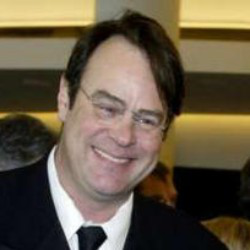

You definitely look like a... Dachshund


Hi, you must be a human..


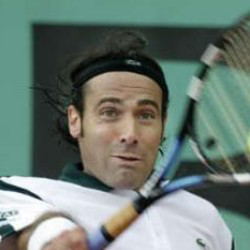

You definitely look like a... Italian greyhound


Hi, you must be a human..


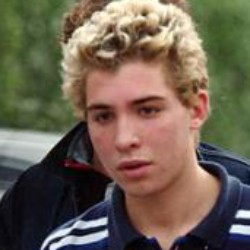

You definitely look like a... Anatolian shepherd dog


I think you are a dog


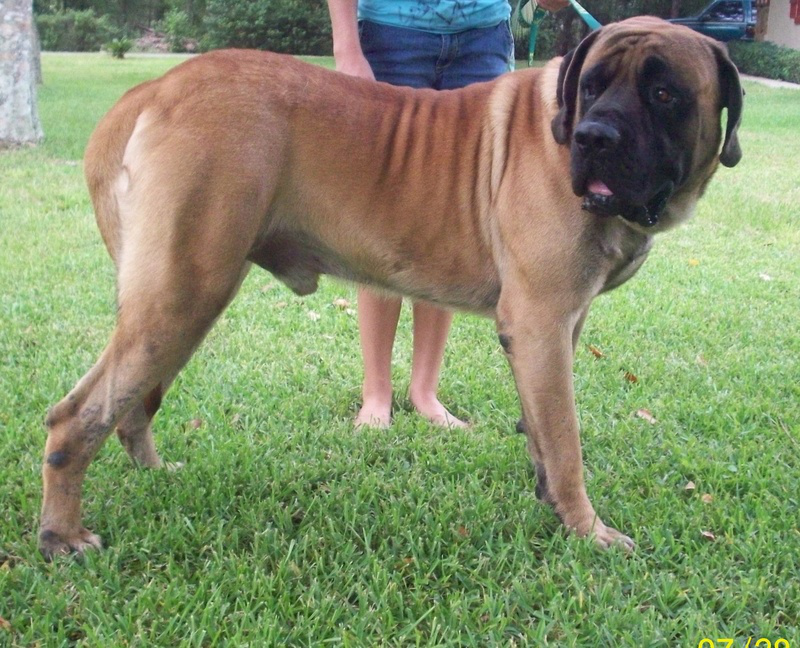

Your breed must be a... Mastiff


I think you are a dog


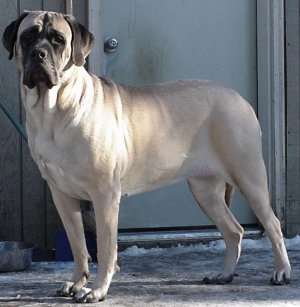

Your breed must be a... Mastiff


Sorry, to my best knowledge, you are neither a human nor a dog.
Jealous for not being classified? Ask Udacity to create a different project.


I think you are a dog


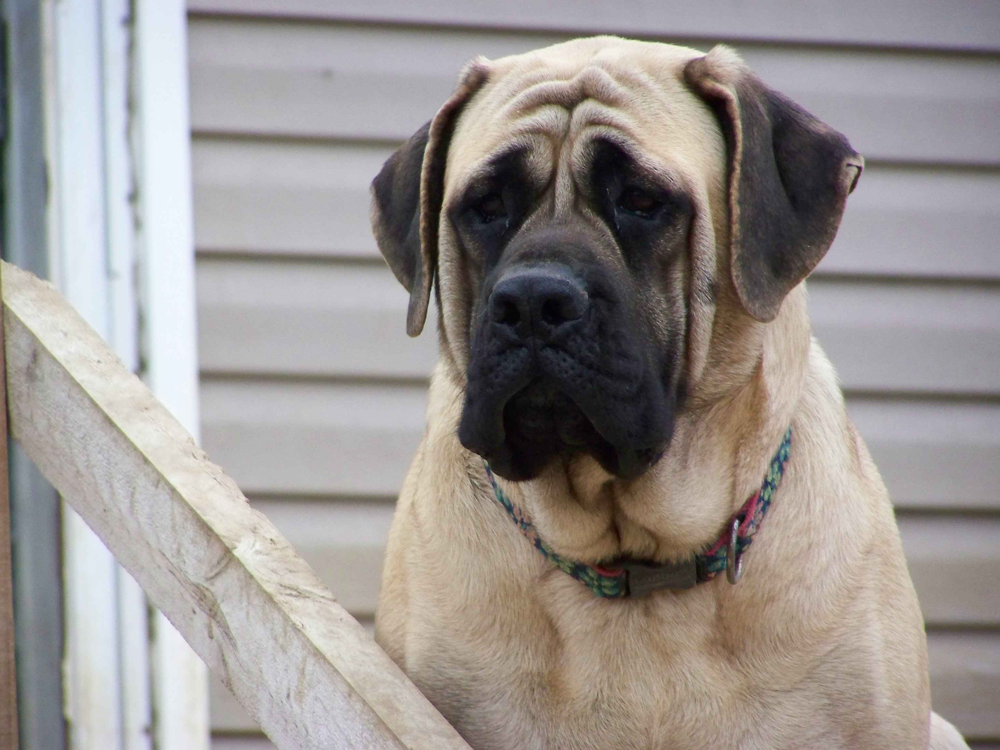

Your breed must be a... Mastiff




In [24]:
## TODO: Execute your algorithm from Step 6 on
## at least 6 images on your computer.
## Feel free to use as many code cells as needed.

## suggested code, below

for file in np.hstack((human_files[:3], dog_files[:4])):
    run_app(file)


'/home/workspace/dog_project/uploaded_imgs/elephant2.png'

Sorry, to my best knowledge, you are neither a human nor a dog.
Jealous for not being classified? Ask Udacity to create a different project.




'/home/workspace/dog_project/uploaded_imgs/photo-1508280756091-9bdd7ef1f463.jpeg'

I think you are a dog


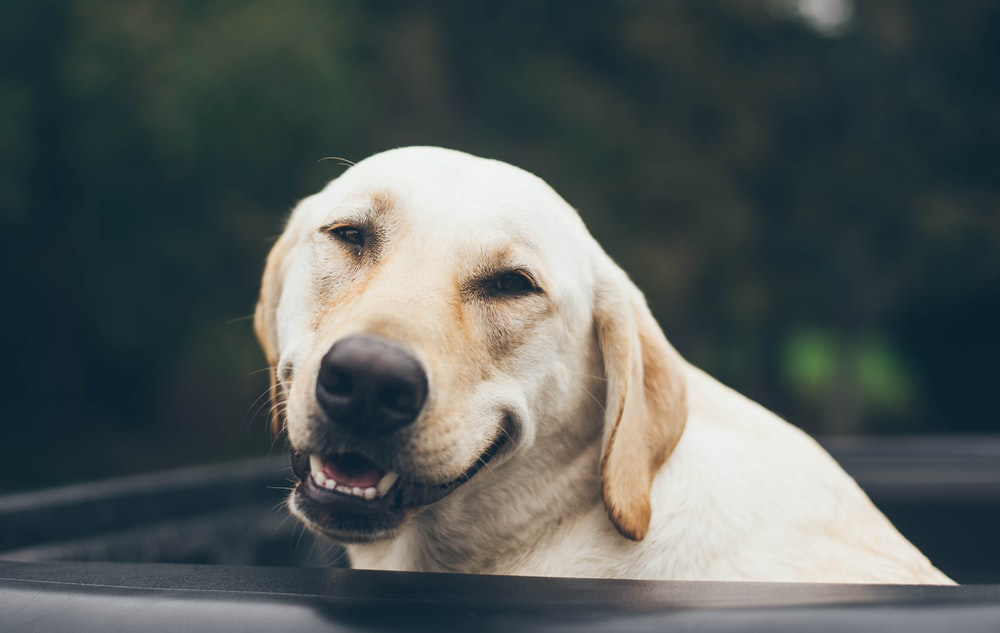

Your breed must be a... Labrador retriever




'/home/workspace/dog_project/uploaded_imgs/shutterstock_371317264-e1576563142389.jpg'

Sorry, to my best knowledge, you are neither a human nor a dog.
Jealous for not being classified? Ask Udacity to create a different project.




'/home/workspace/dog_project/uploaded_imgs/Cristiano-Ronaldo-Top-10-Richest-Football-Players-in-The-World-2017.jpg'

Hi, you must be a human..


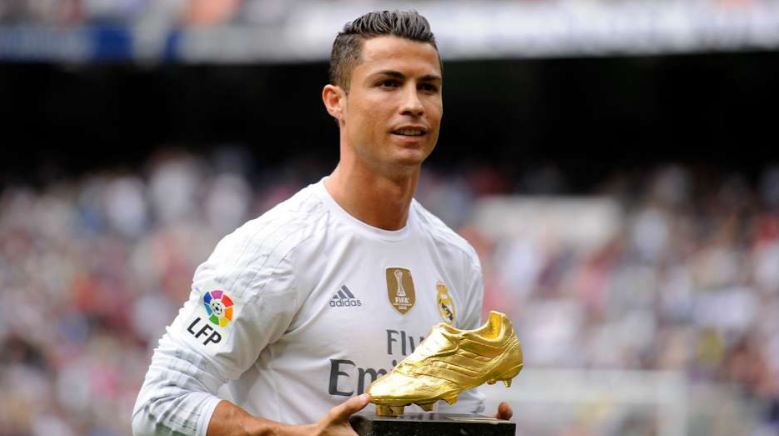

You definitely look like a... Chinese crested




'/home/workspace/dog_project/uploaded_imgs/Neymar_PSG.jpg'

Hi, you must be a human..


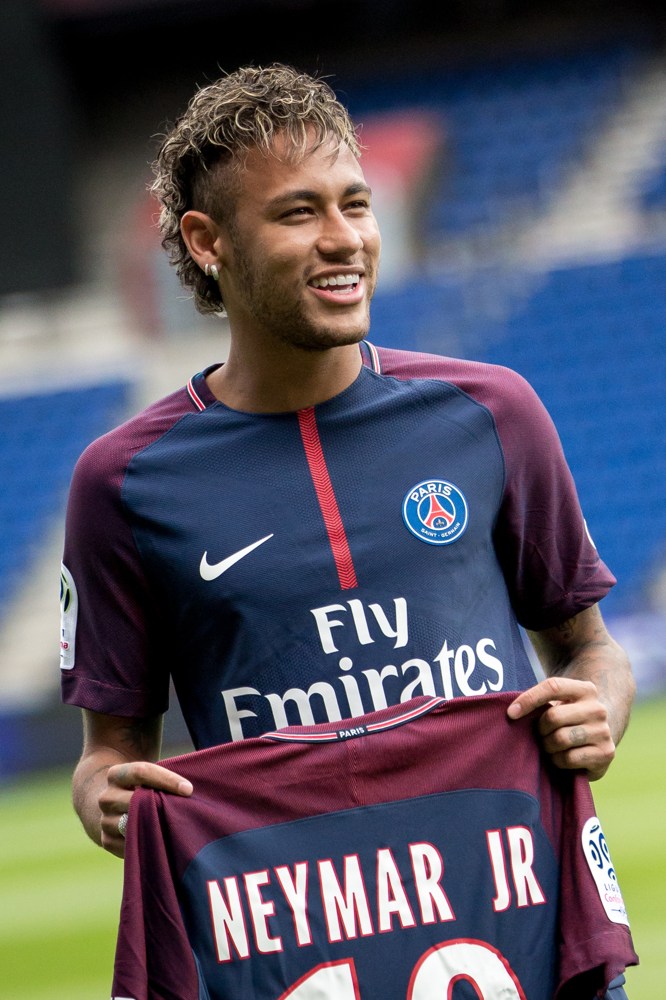

You definitely look like a... English setter




'/home/workspace/dog_project/uploaded_imgs/redCharacter.png'

RuntimeError: Given groups=1, weight[64, 3, 3, 3], so expected input[1, 1, 224, 224] to have 3 channels, but got 1 channels instead

In [39]:
uploaded_files = np.array(glob('/home/workspace/dog_project/uploaded_imgs/*.jp'))

for file in uploaded_files:
    run_app(file)